NOTEBOOK ONE (COPY)

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import numpy as np
import seaborn as sns


In [2]:
adata_file = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_with_ercc_genecode_counts_for_gatk_with_metadata.h5ad"
adata = sc.read_h5ad(adata_file)

#Results Files
adata_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_processed_04192022.h5ad"
adata_unprocessed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_unprocessed_04192022.h5ad"


In [3]:
sc.settings.verbosity = 3             
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.1 scipy==1.6.2 pandas==1.2.4 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.9.8 pynndescent==0.5.5


In [4]:
#checking if the file has mt- genes

def mt_gene_check(adata_object):
    '''Takes an AnnData object. Returns genes that begin with mt- and their index in adata.var.index list'''
    
    gene_list = list(adata_object.var.index)
    for gene in gene_list:
        if 'mt-' == gene[:3]:
            print(gene, list(adata.var.index).index(gene))

In [5]:
mt_gene_check(adata)

mt-Atp6 54224
mt-Atp8 54225
mt-Co1 54226
mt-Co2 54227
mt-Co3 54228
mt-Cytb 54229
mt-Nd1 54230
mt-Nd2 54231
mt-Nd3 54232
mt-Nd4 54233
mt-Nd4l 54234
mt-Nd5 54235
mt-Nd6 54236
mt-Rnr1 54237
mt-Rnr2 54238
mt-Ta 54239
mt-Tc 54240
mt-Td 54241
mt-Te 54242
mt-Tf 54243
mt-Tg 54244
mt-Th 54245
mt-Ti 54246
mt-Tk 54247
mt-Tl1 54248
mt-Tl2 54249
mt-Tm 54250
mt-Tn 54251
mt-Tp 54252
mt-Tq 54253
mt-Tr 54254
mt-Ts1 54255
mt-Ts2 54256
mt-Tt 54257
mt-Tv 54258
mt-Tw 54259
mt-Ty 54260


In [6]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

PREPROCESSING

Remove ERCC genes

In [7]:
def ERCC_gene_check(adata_object):
    '''Takes an AnnData object. Returns list of ERCC genes.'''
    ERCC_tally = 0
    ERCC_genes = []
    gene_list = list(adata_object.var.index)
    for gene in gene_list:
        if 'ERCC-' == gene[:5]:
            ERCC_tally += 1
            ERCC_genes.append(gene)
            
    return ERCC_genes

In [8]:
ERCCs = ERCC_gene_check(adata)

In [10]:
def nonERCC_genes(adata): 
    '''Makes list of nonERCC genes'''
    filtered_genes = []
    gene_list = list(adata.var.index)
    for gene in gene_list:
        if 'ERCC-' != gene[:5]:
            filtered_genes.append(gene)
    return filtered_genes

In [11]:
'''Non ERCC gene list length'''
nonERCCs = nonERCC_genes(adata)
len(nonERCCs) 

54352

In [12]:
'''The same number of ERCC genes (92) will be filtered out'''
(len(adata.var.index)) - (len(nonERCCs))

92

In [13]:
'''Removes ERCC- genes from adata var'''
adata_no_ERCC = adata[:, nonERCCs]

print(f"There are {len(ERCC_gene_check(adata_no_ERCC))} ERCC genes")

There are 0 ERCC genes


In [14]:
'''Number of genes in adata object adata_no_ERCC equals number of nonERCC genes'''

len(adata_no_ERCC.var.index) == len(nonERCCs)

True

Remove Dissociation Genes

In [1]:
dissociation_genes = ['Actg1','Btg1','Cxcl1','Dnajb4','Errfi1','H3f3b','Hspb1','Irf1','Klf6','Mir22hg','Nfkbia','Pcf11',
                      'Pxdc1','Sdc4','Srf','Tpm3','Usp2','Gadd45g','Ankrd1','Btg2','Cyr61','Dusp1','Erfe','Hipk3','Hsph1',
                      'Irf8','Klf9','Mt1','Nfkbiz','Pde4b','Rap1b','Serpine1','Srsf5','Tppp3','Wac','Hspe1','Arid5a','Ccnl1',
                      'Dcn','Dusp8','Fos','Hsp90aa1','Id3','Itpkc','Litaf','Mt2','Nop58','Per1','Rassf1','Skil','Srsf7','Tra2a',
                      'Zc3h12a','Ier5','Atf3','Noct','Ddx3x','Egr1','Fosb','Hsp90ab1','Idi1','Jun','Lmna','Myadm','Nppc',
                      'Phlda1','Rhob','Slc10a6','Stat3','Tra2b','Zfand5','Kcne4','Atf4','Cebpb','Ddx5','Egr2','Fosl2','Hspa1a',
                      'Ier2','Junb','Maff','Myc','Nr4a1','Pnp','Rhoh','Slc38a2','Tagln2','Trib1','Zfp36','Bag3','Cebpd','Des',
                      'Eif1','Gadd45a','Hspa1b','Ier3','Jund','Mafk','Myd88','Odc1','Pnrc1','Ripk1','Slc41a1','Tiparp','Tubb4b',
                      'Zfp36l1','Bhlhe40','Cebpg','Dnaja1','Eif5','Gcc1','Hspa5','Ifrd1','Klf2','Mcl1','Nckap5l','Osgin1',
                      'Ppp1cc','Sat1','Socs3','Tnfaip3','Tubb6','Zfp36l2','Brd2','Csrnp1','Dnajb1','Erf','Gem','Hspa8','Il6',
                      'Klf4','Midn','Ncoa7','Oxnad1','Ppp1r15a','Sbno2','Sqstm1','Tnfaip6','Ubc','Zyx']

In [2]:
len(dissociation_genes)

140

In [19]:
def DISS_var_gene_check(adata):
    '''Takes an AnnData object. Returns list of dissociation genes present in adata object.'''
    DISS_tally = 0
    DISS_genes = []
    gene_list = list(adata.var.index)
    for g in gene_list:
        for d in dissociation_genes:
            if g == d:
                DISS_tally += 1
                DISS_genes.append(g)
    return DISS_genes


In [22]:
result = DISS_var_gene_check(adata_no_ERCC)
len(result)#140

140

In [23]:
for d in dissociation_genes:
    if d not in result:
        print(d)

In [24]:
'''Checking aliases for Fam132b & Ccrn4l. These two genes aren't in adata.var_names.index.'''

Fam132b = ['C1qtnf15','Ctrp15','Myonectin','FAM132B','Erfe']
Ccrn4l = ['Noct','Ccrn4l','Ccr4l','Ccr4c']

for f in Fam132b:
    if f in list(adata_no_ERCC.var_names) or f in list(adata_no_ERCC.var.index):
        print('yes',f)
for c in Ccrn4l:
    if c in list(adata_no_ERCC.var_names)or f in list(adata_no_ERCC.var_names):
        print('yes',c)
        
#Noct was present in adata.var_names.index. Replaced Fam132b with Erfe & filtering it out of adata.var_names.index.
#Erfe was present in adata.var_names.index. Replaced Fam132b with Noct & filtering it out of adata.var_names.index.

#yes Erfe
#yes Noct
#yes Ccrn4l
#yes Ccr4l
#yes Ccr4c
#why are multiple names for same gene present?

yes Erfe
yes Noct
yes Ccrn4l
yes Ccr4l
yes Ccr4c


In [25]:
def nonDISS_genes(adata): 
    '''Makes list of non dissociation genes'''
    filtered_genes = []
    gene_list = set(adata.var.index)
    for g in gene_list:
        if g not in dissociation_genes:
            filtered_genes.append(g)
    return filtered_genes

In [26]:
'''Non dissociation gene list length'''
nonDISSgenes = nonDISS_genes(adata_no_ERCC)
len(set(nonDISSgenes))

54212

In [28]:
'''The same number of dissociation genes (140) will be filtered out'''

(len(adata_no_ERCC.var.index))-(len(nonDISSgenes))==(len(result))

True

In [29]:
'''Removes DISS genes from adata.var'''
adata_no_DISS = adata_no_ERCC[:, nonDISSgenes].copy()

print(f"There are {len(DISS_var_gene_check(adata_no_DISS))} dissociation genes")

There are 0 dissociation genes


In [30]:
DISS_check = DISS_var_gene_check(adata_no_DISS)

In [31]:
len(DISS_check)

0

In [32]:
'''Number of genes in adata object adata_no_DISS equals number of nonDISSgenes'''

len(list(adata_no_DISS.var.index)) == len(nonDISSgenes)

True

In [33]:
len(adata_no_DISS.var.index)

54212

Remove nan cells

In [35]:
'''Create list of cells excluding nan cells '''
adata_nan_cells = adata[adata.obs['cell_ontology_class'] == 'nan'] 
no_ERCC_DISS_list = list(adata_no_DISS.obs.index)
nan_cell_list = list(adata_nan_cells.obs.index)
#nan_cells_df = adata.obs[adata.obs['cell_ontology_class'] == 'nan']

no_nan_no_ERCC_list = []
for cell in no_ERCC_DISS_list:
    if cell not in nan_cell_list:
        no_nan_no_ERCC_list.append(cell)

In [37]:
print('The number of nan cells:',(len(adata_nan_cells.obs['cell_ontology_class'])))

The number of nan cells: 51766


In [38]:
print('The number of nan cells filtered out of cell list:', (len(no_ERCC_DISS_list)-len(no_nan_no_ERCC_list)))

The number of nan cells filtered out of cell list: 51766


In [39]:
'''Cell list without nan cells'''
#adata_no_nan_ERCC = adata_no_ERCC[no_ERCC_list,:]
checky = []
for c in no_nan_no_ERCC_list:
    if c in nan_cell_list:
        checky.append(c)
print(f'Total number of nan cells remaining in cell list is {len(checky)}')

Total number of nan cells remaining in cell list is 0


In [48]:
'''Remove nan cells from adata_no_ERCC obs'''

adata_no_nan_ERCC = adata_no_DISS[no_nan_no_ERCC_list,:]

In [49]:
print(f'The number of ERCC genes present in adata_no_nan_ERCC is {len(ERCC_gene_check(adata_no_nan_ERCC))}')        

The number of ERCC genes present in adata_no_nan_ERCC is 0


In [50]:
'''Check if nan cells are still remaining'''

nancheck = adata_no_nan_ERCC[adata_no_nan_ERCC.obs['cell_ontology_class']=='nan']
print(f'The number of nan cells remaining in adata object adata_no_nan_ERCC is {(len(nancheck.obs))}')

The number of nan cells remaining in adata object adata_no_nan_ERCC is 0


In [52]:
'''Check if dissociation genes are present'''
for d in dissociation_genes:
    if d in set(adata_no_nan_ERCC.var.index):
        print(d)

**ANALYSIS**

/mnt/ibm_sm/home/lea.mcgeever/anaconda3/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:02)


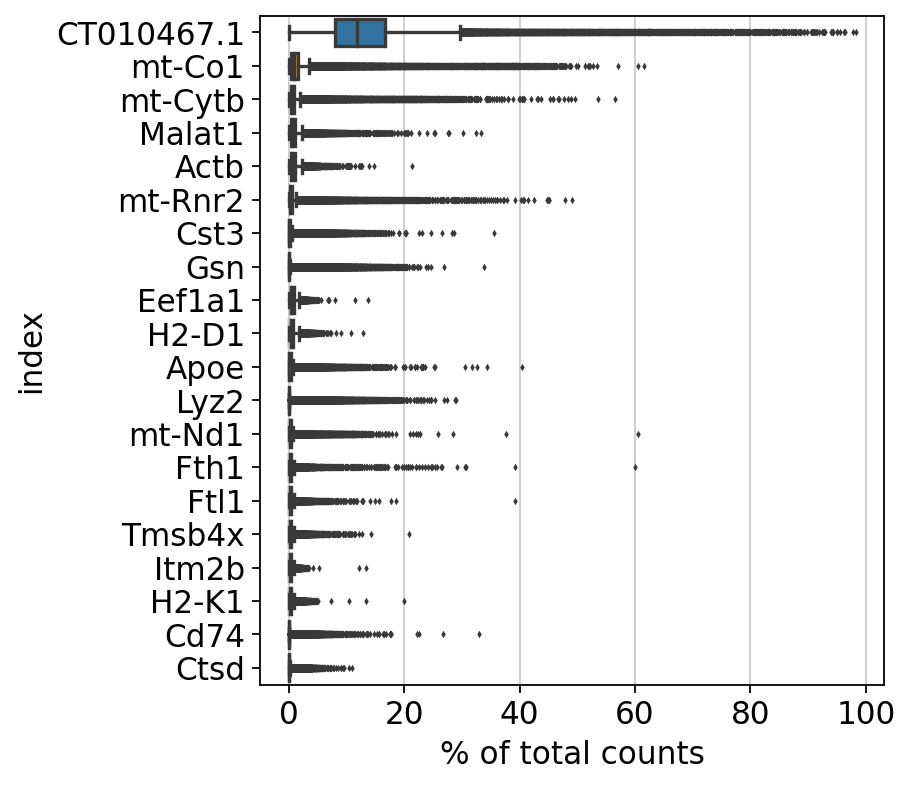

In [53]:
sc.pl.highest_expr_genes(adata_no_nan_ERCC, n_top=20, )

Basic Filtering

In [54]:
'''Filter out cells that express less than 250 genes, less than 2500 counts'''
sc.pp.filter_cells(adata_no_nan_ERCC, min_genes = 250)
sc.pp.filter_cells(adata_no_nan_ERCC, min_counts = 2500)

filtered out 5821 cells that have less than 250 genes expressed
filtered out 459 cells that have less than 2500 counts


In [55]:
'''Annotate mitochondrial genes as 'mt' '''
adata_no_nan_ERCC.var['mt'] = adata_no_nan_ERCC.var_names.str.startswith('mt-')  
sc.pp.calculate_qc_metrics(adata_no_nan_ERCC, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [56]:
adata_no_nan_ERCC.write(adata_unprocessed)

A violin plot of some of the computed quality measures:

    -the number of genes expressed in the count matrix
    -the total counts per cell
    -the percentage of counts in mitochondrial genes


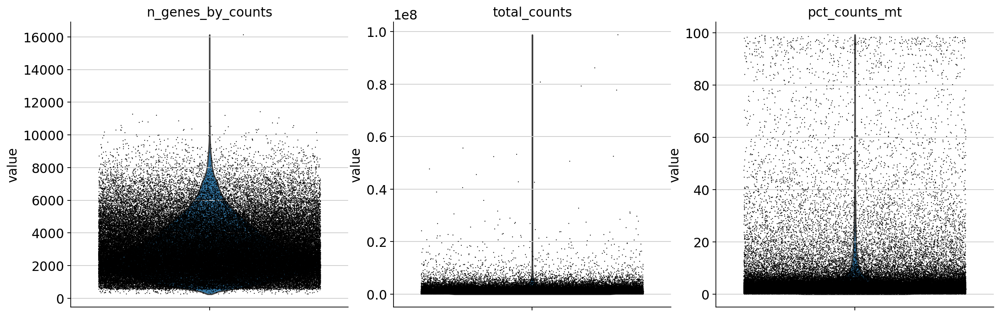

In [57]:
sc.pl.violin(adata_no_nan_ERCC, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Won't be remove cells that have too many mitochondrial genes expressed, but will be removing too many total counts:

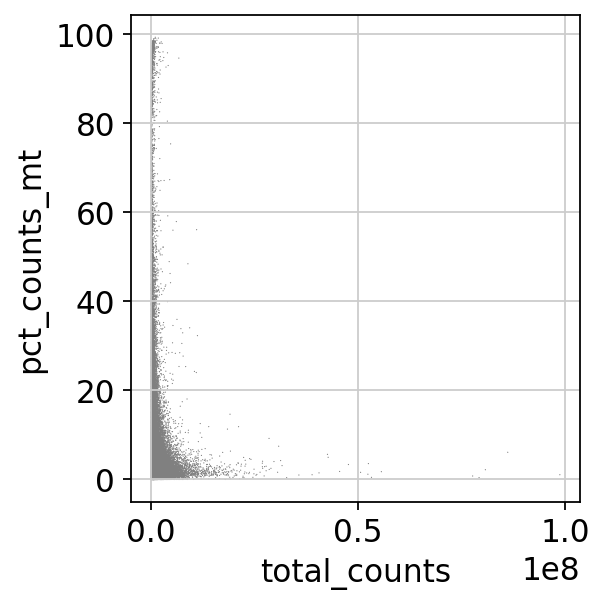

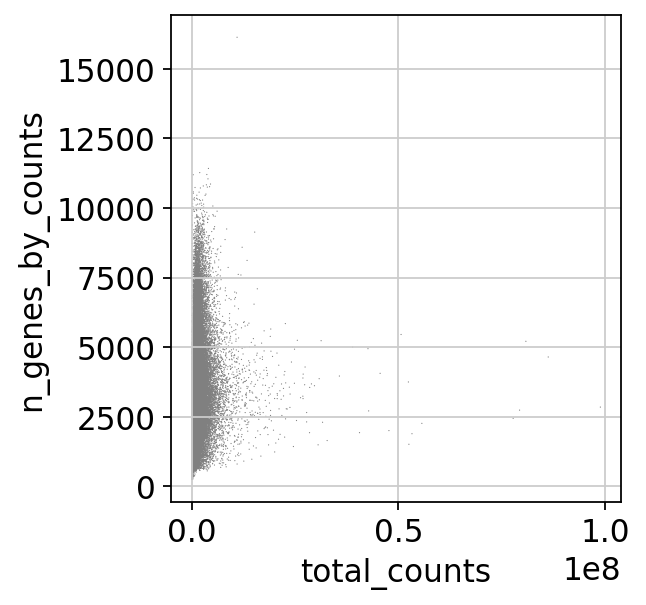

In [58]:
sc.pl.scatter(adata_no_nan_ERCC, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_no_nan_ERCC, x='total_counts', y='n_genes_by_counts')

Actually do the filtering by slicing the AnnData object.

<AxesSubplot:xlabel='n_genes_by_counts', ylabel='Count'>

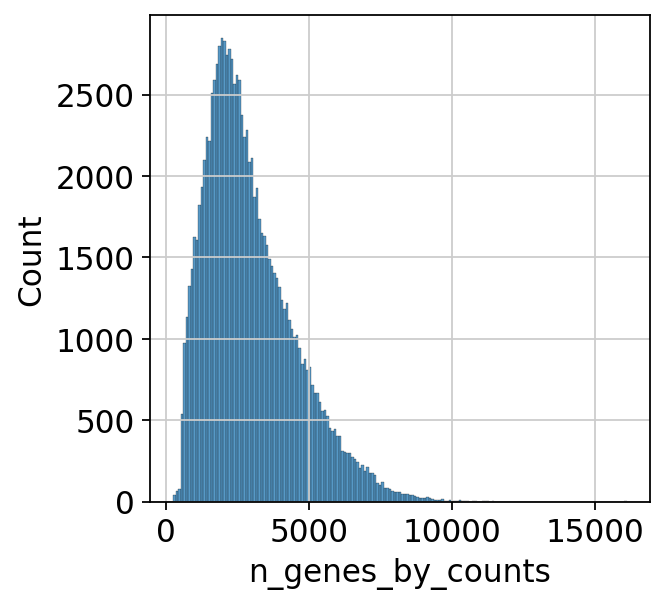

In [59]:
'''
Was curious about the <2500 filtering, so AM suggested plotting a histogram.
We see that 2500 is not a good cut off, removed n_genes_by_counts filter from processing.
'''
sns.histplot(adata_no_nan_ERCC.obs.n_genes_by_counts)

Total-count normalize (library-size correct) the data matrix 𝐗 to 10,000 reads per cell, so that counts become comparable among cells.

In [60]:
sc.pp.normalize_total(adata_no_nan_ERCC, target_sum=1e4)

normalizing counts per cell
    finished (0:00:01)


Logarithmize the data:

In [61]:
sc.pp.log1p(adata_no_nan_ERCC)

Identify highly-variable genes.

In [62]:
sc.pp.highly_variable_genes(adata_no_nan_ERCC, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [63]:
adata_no_nan_ERCC.raw = adata_no_nan_ERCC

No scaling so that gene expression scores aren't negative

**Principal component analysis**

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [64]:
sc.tl.pca(adata_no_nan_ERCC, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:22)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

In [4]:
mt_genes = [
    "mt-Atp6",
    "mt-Atp8",
    "mt-Co1",
    "mt-Co2",
    "mt-Co3",
    "mt-Cytb",
    "mt-Nd1",
    "mt-Nd2",
    "mt-Nd3",
    "mt-Nd4",
    "mt-Nd4l",
    "mt-Nd5",
    "mt-Nd6",
    "mt-Rnr1",
    "mt-Rnr2",
    "mt-Ta",
    "mt-Te",
    "mt-Tf",
    "mt-Ti",
    "mt-Tl1",
     "mt-Tl2", #
    "mt-Tm",
    "mt-Tp",
    "mt-Tq",
    "mt-Tt",
    "mt-Tv"
]

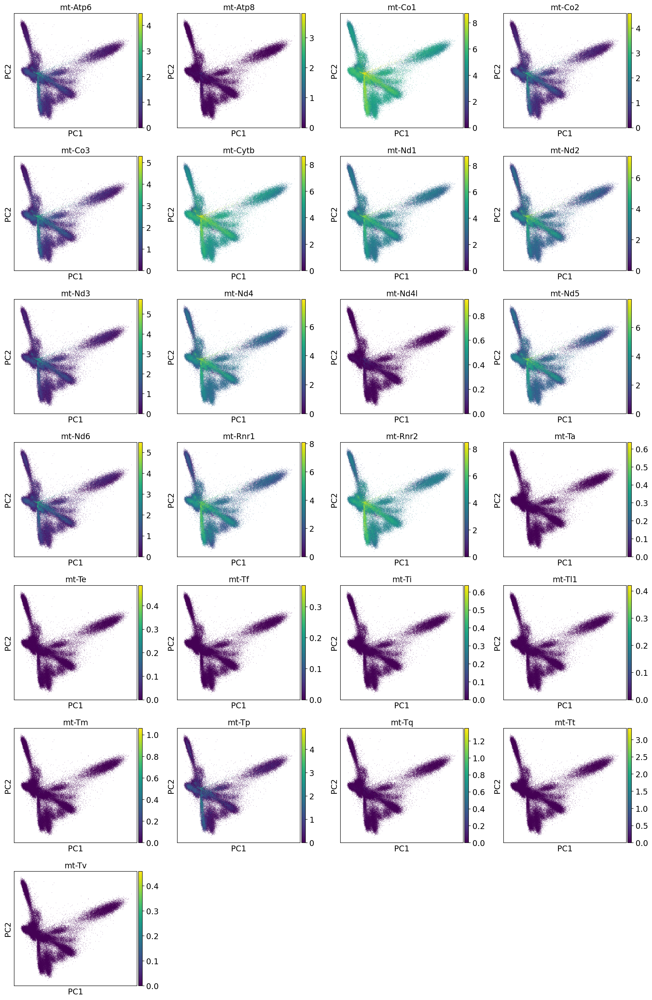

In [66]:
sc.pl.pca(adata_no_nan_ERCC, color=mt_genes)

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function sc.tl.louvain() or tSNE sc.tl.tsne(). In our experience, often a rough estimate of the number of PCs does fine.

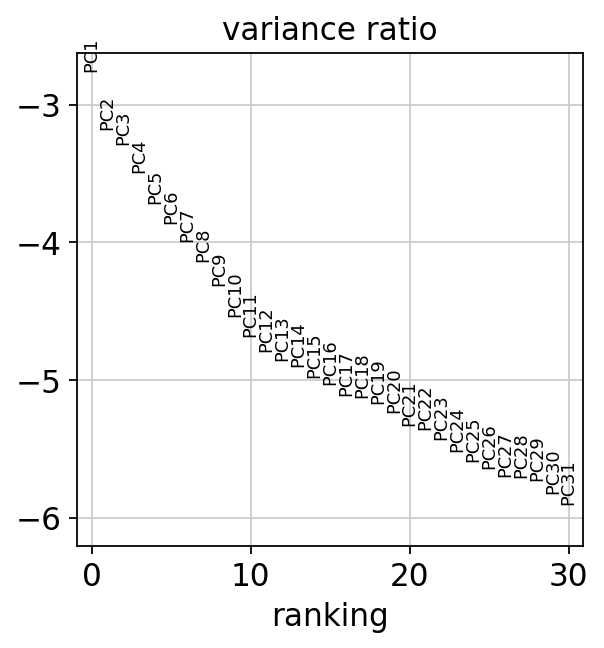

In [67]:
sc.pl.pca_variance_ratio(adata_no_nan_ERCC, log=True)

Save the result.

In [68]:
'''Save adata file'''

adata_no_nan_ERCC.write(adata_processed)

**Computing the neighborhood graph**

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat’s results, let’s take the following values.

In [69]:
sc.pp.neighbors(adata_no_nan_ERCC, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)


**Embedding the neighborhood graph**

We suggest embedding the graph in two dimensions using UMAP (McInnes et al., 2018), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

running Leiden clustering
    finished: found 69 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:37)


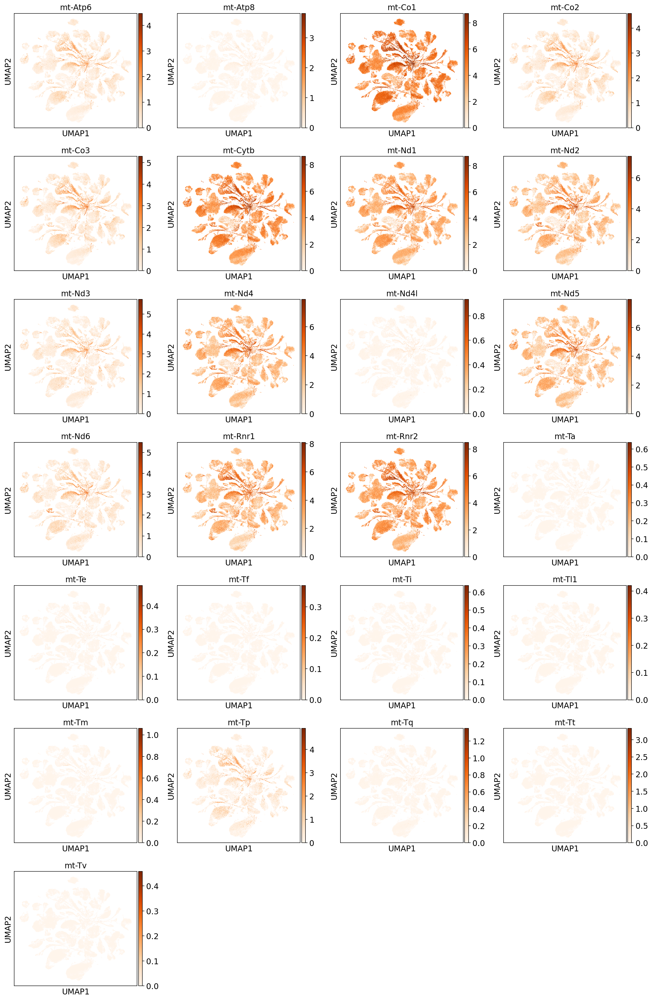

In [70]:
sc.tl.leiden(adata_no_nan_ERCC)
sc.tl.umap(adata_no_nan_ERCC)
sc.pl.umap(adata_no_nan_ERCC, color= mt_genes, use_raw=False, cmap = "Oranges", save = 'adata_all_ages.pdf')

As we set the .raw attribute of adata, the previous plots showed the “raw” (normalized, logarithmized, but uncorrected) gene expression. You can also plot the scaled and corrected gene expression by explicitly stating that you don’t want to use .raw.

In [71]:
'''Save adata file'''

adata_no_nan_ERCC.write(adata_processed)

**Finding marker genes**

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:25)


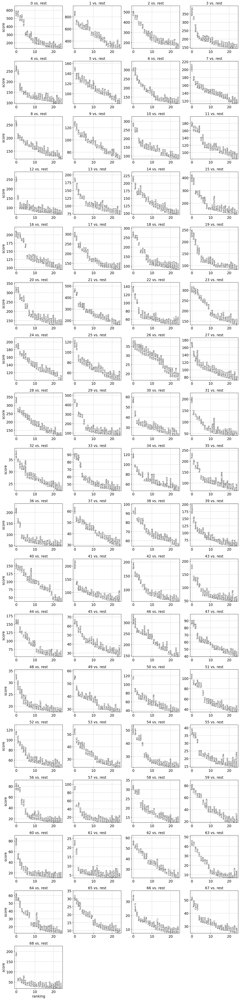

In [72]:
sc.tl.rank_genes_groups(adata_no_nan_ERCC, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata_no_nan_ERCC, n_genes=25, sharey=False)

<AxesSubplot:xlabel='pct_counts_mt', ylabel='Count'>

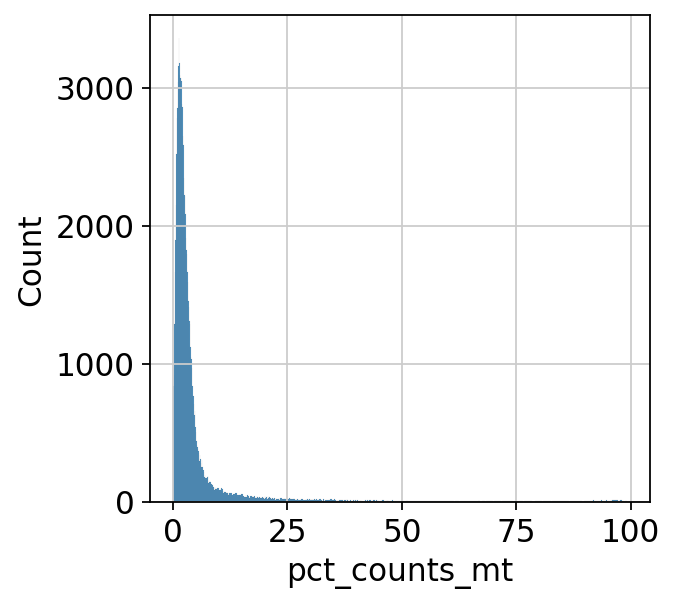

In [73]:
#Should I filter out 25%+?

sns.histplot(adata_no_nan_ERCC.obs["pct_counts_mt"])

In [74]:
sc.settings.verbosity = 2  # reduce the verbosity

The result of a Wilcoxon rank-sum (Mann-Whitney-U) test is very similar. We recommend using the latter in publications, see e.g., Sonison & Robinson (2018). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

ranking genes
    finished (0:15:38)


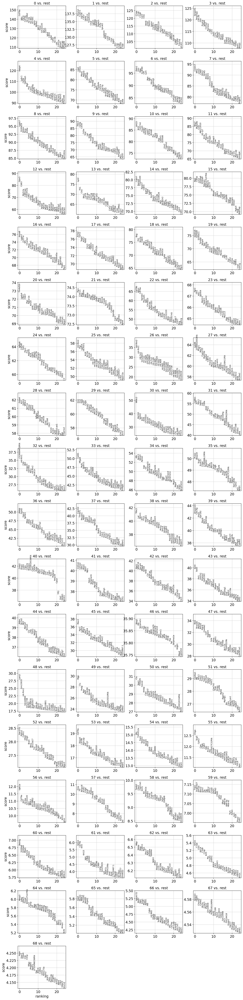

In [77]:
sc.tl.rank_genes_groups(adata_no_nan_ERCC, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata_no_nan_ERCC, n_genes=25, sharey=False)

In [78]:
'''Save adata file'''

adata_no_nan_ERCC.write(adata_processed)

As an alternative, let us rank genes using logistic regression. For instance, this has been suggested by Natranos et al. (2018). The essential difference is that here, we use a multi-variate appraoch whereas conventional differential tests are uni-variate. Clark et al. (2014) has more details.

In [79]:
'''Open adata file'''

adata_no_nan_ERCC = sc.read(adata_processed)

In [80]:
pd.DataFrame(adata_no_nan_ERCC.uns['rank_genes_groups']['names']).head(10)

,0,1,2,3,4,5,6,7,8,9,...,59,60,61,62,63,64,65,66,67,68
0,Cd79a,P2ry12,C1qa,Serpinf1,Fabp4,Lsp1,Fbln1,Cmtm7,Lgals7,Trbc2,...,Tnp1,Retnlg,Krt14,Mbp,Krt15,Mmp3,Gja4,Igkv4-72,Spock3,Aspn
1,Igkc,Cx3cr1,C1qc,Serping1,Ly6c1,Gm2a,Gsn,Nfe2,S100a14,Cd3g,...,Scgb1b27,S100a8,Cd79a,Mobp,C1qa,Ly6g,Slc2a1,Mup7,Ogdhl,Foxr1
2,Cd74,Gpr34,C1qb,Clec3b,Cd36,Plbd1,Mgp,Lmo2,Dmkn,Cd3d,...,Smr3a,S100a9,Krt5,Mog,Ctss,Ltb4r1,Wfdc1,Mpo,Ctnna2,Thbs4
3,Cd79b,Csf1r,Cst3,Gsn,Gpihbp1,Napsa,Ccdc80,Cdk6,Perp,Cd3e,...,Mucl2,Plbd1,Krt15,Cldn11,Krt14,Fmod,Tsc22d1,Kng1,Col9a1,Cilp
4,H2-DMb2,Hexb,Ctss,Pcolce,Mgll,Gpx1,Cfh,Prtn3,Krt6a,Trac,...,Prm2,Gm2a,Igkc,Plp1,C1qb,I830127L07Rik,Apold1,Mup3,Htr2a,Clmp
5,H2-Aa,P2ry13,Hexb,Igfbp6,Flt1,Alox5ap,Lum,H2afy,Gsto1,Lat,...,Pip,Ms4a1,Cdk6,Dhcr7,C1qc,Lcn2,Pcp4l1,Apoa1,Crtac1,Sftpc
6,H2-Ab1,Tmem119,Ctsd,Col1a2,Cav1,Lyz2,Bgn,Ifitm1,Igfbp2,Il2rg,...,Pgc,Slpi,Vpreb3,Itgb5,Krt5,Camp,Oaz2,Alb,Zfp14,Angptl2
7,H2-Eb1,Ctsd,Trem2,Rarres2,Cd300lg,Fxyd5,Dpt,Stmn1,Serpinb5,Tmsb10,...,Hbb-y,Lcn2,Ighm,Frmd4a,Ptn,Ltf,Slc9a3r2,Cdk6,Gm10658,Pamr1
8,Ighm,Lgmn,Lgmn,Dpt,Adgrf5,Tyrobp,Htra3,Gm11223,Pitx1,Shisa5,...,Prm1,Tnfrsf13c,Ly6d,Tubb4a,Fxyd3,Ngp,Tmem100,mt-Nd2,Fign,4732496C06Rik
9,Ms4a1,Selplg,Cx3cr1,C1s1,Esam,Cytip,Serping1,Dapp1,Sfn,Lck,...,Cryaa,Lyz2,Rpl7,Aplp1,Grem1,Chil3,Pltp,H2afy,9330182L06Rik,Dpt


In [81]:
result = adata_no_nan_ERCC.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(5)


,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,64_n,64_p,65_n,65_p,66_n,66_p,67_n,67_p,68_n,68_p
0,Cd79a,0.0,P2ry12,0.0,C1qa,0.0,Serpinf1,0.0,Fabp4,0.0,...,Mmp3,2.382573e-09,Gja4,8.347156e-09,Igkv4-72,2.124002e-07,Spock3,0.000005,Aspn,0.000022
1,Igkc,0.0,Cx3cr1,0.0,C1qc,0.0,Serping1,0.0,Ly6c1,0.0,...,Ly6g,2.793996e-09,Slc2a1,8.724386e-09,Mup7,3.115159e-07,Ogdhl,0.000005,Foxr1,0.000023
2,Cd74,0.0,Gpr34,0.0,C1qb,0.0,Clec3b,0.0,Cd36,0.0,...,Ltb4r1,3.365594e-09,Wfdc1,8.860546e-09,Mpo,3.349218e-07,Ctnna2,0.000005,Thbs4,0.000023
3,Cd79b,0.0,Csf1r,0.0,Cst3,0.0,Gsn,0.0,Gpihbp1,0.0,...,Fmod,3.408657e-09,Tsc22d1,1.129781e-08,Kng1,3.562162e-07,Col9a1,0.000005,Cilp,0.000023
4,H2-DMb2,0.0,Hexb,0.0,Ctss,0.0,Pcolce,0.0,Mgll,0.0,...,I830127L07Rik,3.721980e-09,Apold1,1.224837e-08,Mup3,4.377023e-07,Htr2a,0.000005,Clmp,0.000024


ranking genes
    finished (0:00:58)


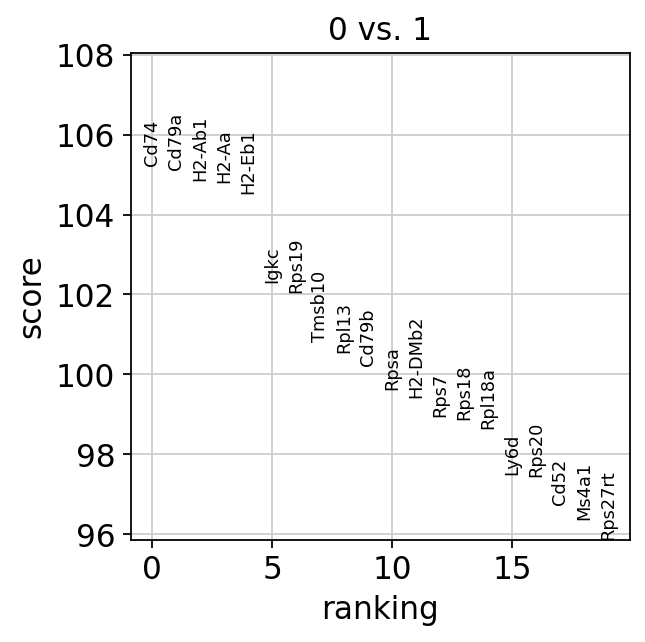

In [82]:
sc.tl.rank_genes_groups(adata_no_nan_ERCC, 'leiden', groups=['0'], reference='1', method='wilcoxon')
sc.pl.rank_genes_groups(adata_no_nan_ERCC, groups=['0'], n_genes=20)

Reload the object with the computed differential expression (i.e. DE via a comparison with the rest of the groups):

In [83]:
'''Open file'''
adata_no_nan_ERCC = sc.read(adata_processed)

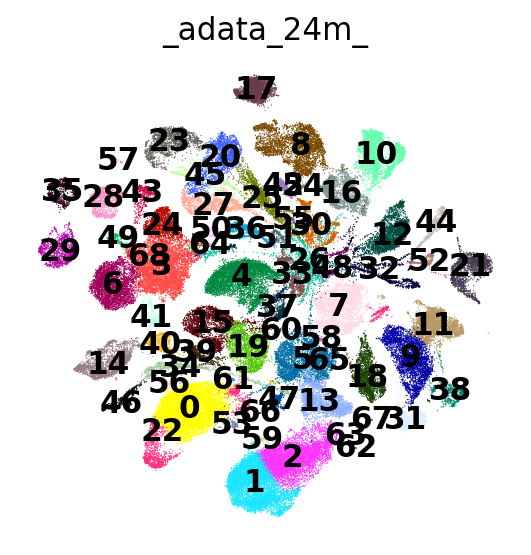

In [84]:
sc.pl.umap(adata_no_nan_ERCC, color='leiden', legend_loc='on data', title='_adata_24m_', frameon=False)

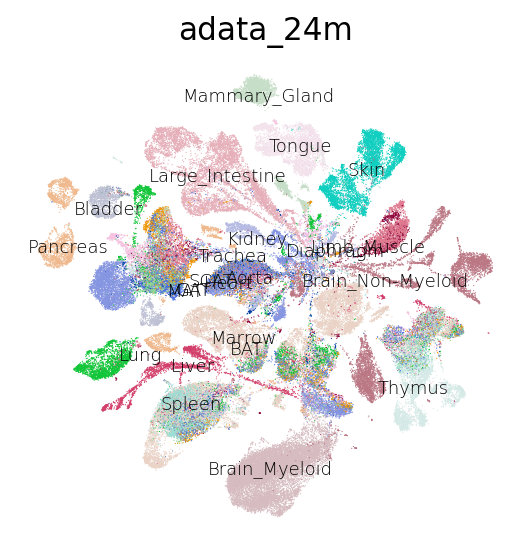

In [85]:
sc.pl.umap(adata_no_nan_ERCC, color='tissue', legend_fontweight = 'light', legend_fontsize= 'xx-small', legend_loc='on data', title='adata_24m', frameon=False)


Now that we annotated the cell types, let us visualize the marker genes.

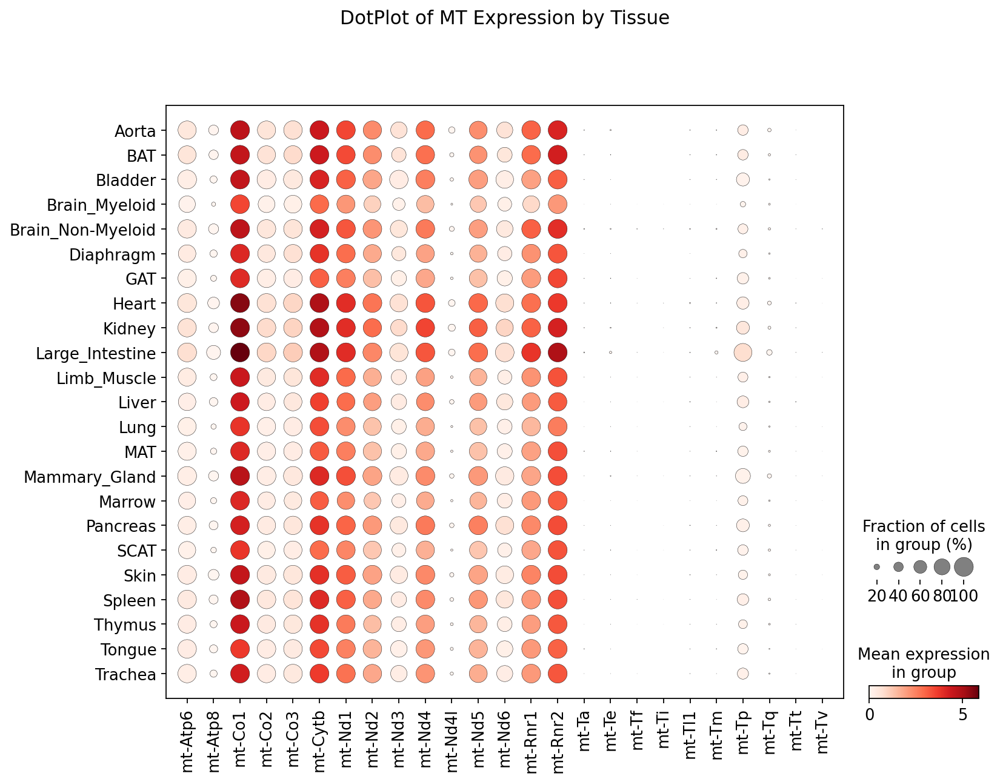

In [86]:
sc.pl.dotplot(adata_no_nan_ERCC, mt_genes, groupby='tissue', title = 'DotPlot of MT Expression by Tissue')

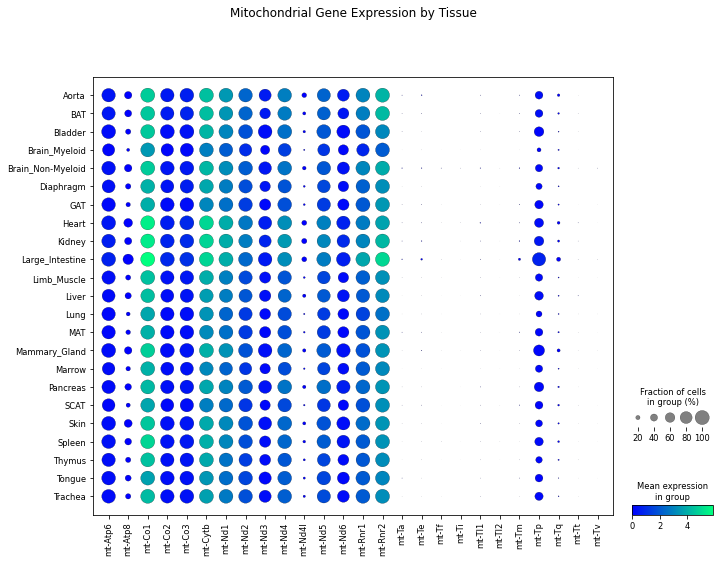

In [5]:
import scanpy as sc
adata = sc.read_h5ad(adata_processed)

sc.pl.DotPlot(adata, mt_genes, groupby='tissue', title = 'Mitochondrial Gene Expression by Tissue').savefig('DotPlot_of_Mitochondrial_Gene Expression_by_Tissue_05192022.png', bbox_inches='tight')


There is also a very compact violin plot.

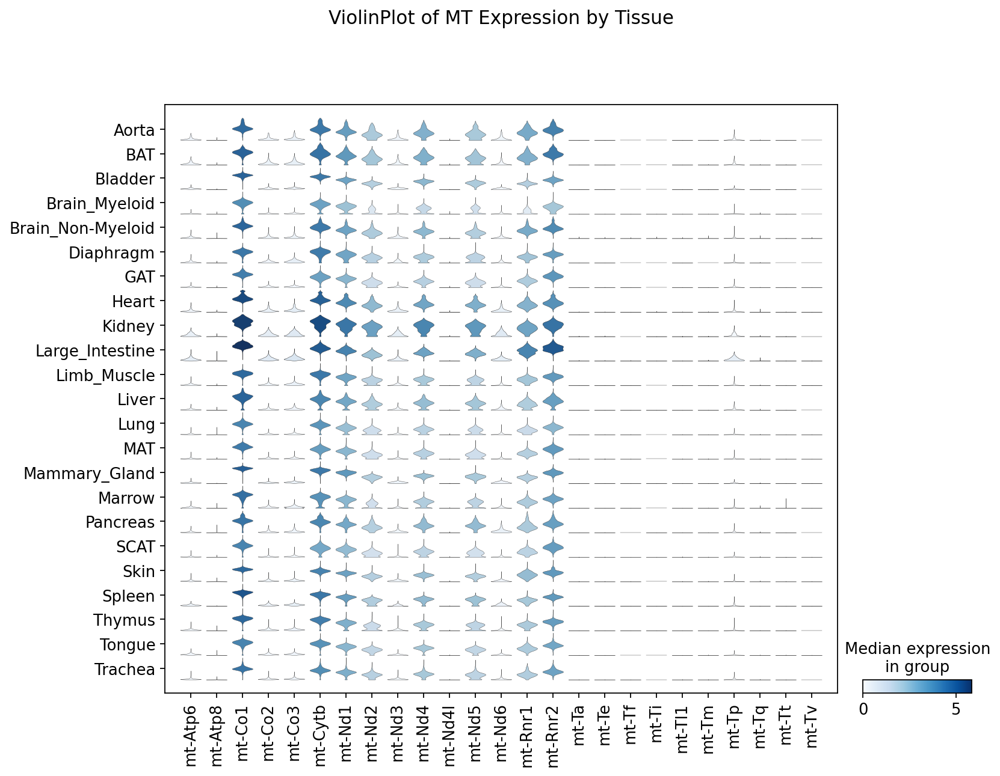

In [87]:
sc.pl.stacked_violin(adata_no_nan_ERCC, mt_genes, groupby='tissue', rotation=90,title = 'ViolinPlot of MT Expression by Tissue', save = '_adata_24m_by_tissue.pdf')


In [175]:
'''Save adata file'''
adata_no_nan_ERCC.write(adata_processed, compression='gzip')


In [176]:
canifile = sc.read_h5ad(adata_processed)

In [177]:
canifile

AnnData object with n_obs × n_vars = 103180 × 54352
    obs: 'FACS.selection', 'age', 'cell', 'cell_matching', 'cell_ontology_class', 'cell_ontology_id', 'free_annotation', 'gencode_index', 'method', 'mouse.id', 'newcellnames', 'sex', 'subtissue', 'tissue', 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tissue_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [178]:

for e in ERCC_genes:
    if e in list(canifile.var.index):
        print('True')
    else:
        print('False')

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False


In [179]:
for m in mt_genes:
    if m in list(canifile.var.index):
        print('True')
    else:
        print('False')

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
